<a href="https://colab.research.google.com/github/Lambda-School-Labs/Labs26-Citrics-DS-TeamC/blob/fatai_king/My_Copy_of_Copy_Real_Estate.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# EDA

In [ ]:
# pip install quandl

In [ ]:
# # PACKAGES
# import quandl
# import numpy as np
# import pandas as pd
# import seaborn as sns
# import plotly.express as px
# import matplotlib.pyplot as plt

In [ ]:
# https://www.quandl.com/data/BLSE-BLS-Employment-Unemployment/documentation

In [ ]:
# # API Key
# quandl.ApiConfig.api_key = 'db1wD3BsXUWh1FzuYCNQ'

In [ ]:
# # Getting tables from Quandl
# data = quandl.get_table('ZILLOW/DATA', 
#                         indicator_id=['Z1BR', 'Z2BR', 'Z3BR', 'Z4BR', 'Z5BR'], 
#                         region_id='54720')


# data = quandl.get_table('ZILLOW/DATA',
#                         indicator_id=['Z1BR'],
#                         paginate=True)

# indicators = quandl.get_table('ZILLOW/INDICATORS', paginate=True)
# regions = quandl.get_table('ZILLOW/REGIONS', paginate=True)

In [ ]:
# ## Reading in the CSVs
# data = pd.read_csv('z1br.csv')
# indicators = pd.read_csv('zillow_indicator_data.csv')
# regions = pd.read_csv('zillow_regions_data.csv')

In [ ]:
# print(data.shape)
# data.head()

### Indicators:
ZALL; 

ZHVI; All Homes (SFR, Condo/Co-op) Time Series ($); Home values

SSSW; Median Sale Price (Smooth, SFR only, Weekly View);	Inventory and sales

SSSM;	Median Sale Price (Smooth, SFR only, Monthly);	Inventory and sales

SRSW;	Median Sale Price (Raw, SFR only, Weekly View);	Inventory and sales

SRSM;	Median Sale Price (Raw, SFR only, Monthly);	Inventory and sales

SASW;	Median Sale Price (Smooth & Seasonally Adjuste...);	Inventory and sales

SASM;	Median Sale Price (Smooth & Seasonally Adjuste...);	Inventory and sales

SAAW;	Median Sale Price (Smooth & Seasonally Adjuste...);	Inventory and sales

SAAM;	Median Sale Price (Smooth & Seasonally Adjuste...);	Inventory and sales

RSSA;	ZORI (Smoothed, Seasonally Adjusted): All Home...);	Rentals

RSNA;	ZORI (Smoothed): All Homes Plus Multifamily Ti...);	Rentals

LSSW;	Median List Price (Smooth, SFR Only, Weekly View);	Inventory and sales

LSSM;	Median List Price (Smooth, SFR Only, Monthly);	Inventory and sales

LRSW;	Median List Price (Raw, SFR Only, Weekly View);	Inventory and sales

LRSM;	Median List Price (Raw, SFR Only, Monthly);	Inventory and sales

CSSW;	Share of Listings With a Price Cut (Smooth, SF...);	Inventory and sales

CSSM;	Share of Listings With a Price Cut (Smooth, SF...);	Inventory and sales

CRSW;	Share of Listings With a Price Cut (Raw, SFR O...);	Inventory and sales

CRSM;	Share of Listings With a Price Cut (Raw, SFR O...);	Inventory and sales


In [ ]:
# indicator_id = ['ZSFH','ZALL','SSSW','SSSM','SRSW','SRSM','SASW','SASM', 
#                 'SAAW','SAAM','RSSA','RSNA','LSSW','LSSM','LRSW','LRSM', 
#                 'CSSW','CSSM','CRSV','CRSM']

In [ ]:
# print(indicators.shape)
# indicators

In [ ]:
# drop_lst = []
# for i in indicators['indicator_id']:
#   if i not in indicator_id:
#     drop_lst.append(i)

# drop_lst

In [ ]:
# indicators.columns

In [ ]:
# indicators_pt = pd.pivot(indicators, columns='category', index='indicator_id')

In [ ]:
# indicators_pt

# REGIONS - OVERVIEW

In [ ]:
# regions

In [ ]:
# print(regions['region_type'].value_counts())
# print('---')
# print(regions['region_type'].value_counts(normalize=True))

In [ ]:
# region_type_specific_data = {}

# for t in regions['region_type'].unique():
#   if t in ['city','county', 'metro', 'state']:
#     rtype = regions[regions['region_type'] == t]
#     print(t)
#     print('---')
#     print(rtype[:5])
#     print('\n')
#     region_type_specific_data[t] = rtype

In [ ]:
# for i in region_type_specific_data:
#   print(i)

In [ ]:
# for i in region_type_specific_data:
#   print(i)
#   print('---')
#   print(region_type_specific_data[i])
#   print('\n')

## **REGIONS CLEANING**

In [ ]:
# ## TOTAL PARTS: 8

# # PART 1:
# cities = regions[regions['region_type'] == 'city']
# cities.drop(columns=['None','region_type'], inplace=True)
# cities.reset_index(inplace=True)

# # PART 2:
# region_breakdown = cities['region'].str.split("; ", expand=True)
# region_breakdown = region_breakdown.rename(columns={0:'city', 1:'state', 2:'region', 3:'county'})

# # PART 3:
# region_id = cities.drop(columns=['index', 'region'])
# df = pd.concat([region_id, region_breakdown], axis=1)

# # PART 4:
# cols = ['city', 'state', 'region', 'county']
# df[cols] = df[cols].astype('string')

# # PART 5:
# psc_data = pd.read_csv('Postal_States_Capitals_CSV.csv')

# postals = list(psc_data['Postal'])
# states = list(psc_data['State'])
# capitals = list(psc_data['Capital'])

# capitals_postals_dict = dict(zip(capitals, postals))

# # PART 6:
# arr = []
# index = 0

# for i in df['city']:
#   if i in capitals_postals_dict:
#     if capitals_postals_dict[i] == df['state'][index]:
#       zipped = [i, capitals_postals_dict[i], df['region_id'][index]]
#       arr.append(zipped)
#   index += 1

# print(len(arr))
# arr

# # PART 7:
# present_cities = []

# for lst in arr:
#   city = lst[0]
#   postal = lst[1]
#   # print(city, postal)
#   present_cities.append(city)

# print(len(present_cities))
# present_cities


# # PART 8:
# for i in capitals_postals_dict:
#   if i not in present_cities:
#     print(capitals_postals_dict[i])


In [ ]:
# ## PART: 1
# cities = regions[regions['region_type'] == 'city']
# cities.drop(columns=['None','region_type'], inplace=True)
# cities.reset_index(inplace=True)

# print(cities.shape)
# cities.head()

In [ ]:
# ## PART: 2
# region_breakdown = cities['region'].str.split("; ", expand=True)
# region_breakdown = region_breakdown.rename(columns={0:'city', 1:'state', 2:'region', 3:'county'})

# print(region_breakdown.shape)
# region_breakdown.head()

In [ ]:
# ## PART: 3
# region_id = cities.drop(columns=['index', 'region'])
# df = pd.concat([region_id, region_breakdown], axis=1)

# print(df.shape)
# df.head()

In [ ]:
# df.dtypes

In [ ]:
# ## PART: 4
# cols = ['city', 'state', 'region', 'county']
# df[cols] = df[cols].astype('string')

# df.dtypes

In [ ]:
# df.head()

In [ ]:
# ## PART: 5
# psc_data = pd.read_csv('Postal_States_Capitals_CSV.csv')
# # psc_data

# postals = list(psc_data['Postal'])
# states = list(psc_data['State'])
# capitals = list(psc_data['Capital'])
# # print(len(postals), len(states), len(capitals))

# capitals_postals_dict = dict(zip(capitals, postals))
# capitals_postals_dict


In [ ]:
# ## PART: 6

# arr = []
# index = 0

# for i in df['city']:
#   # print(i)
#   if i in capitals_postals_dict:
#     if capitals_postals_dict[i] == df['state'][index]:
#       zipped = [i, capitals_postals_dict[i], df['region_id'][index]]
#       arr.append(zipped)
#   index += 1

# print(len(arr))
# arr


## FUNCTION:
# def cities_states_regionid_func(df, dictionary):
#   arr = []
#   index = 0

#   for i in df['city']:
#     # print(i)
#     if i in dictionary:
#       if dictionary[i] == df['state'][index]:
#         zipped = [i, dictionary[i], df['region_id'][index]]
#         arr.append(zipped)
#     index += 1

#   print(len(arr))
#   return arr

# ## CHECK: Calling function 
# new_arr = cities_states_regionid_func(df, capitals_postals_dict)
# new_arr

In [ ]:
# ## PART: 7

# present_cities = []

# for lst in arr:
#   city = lst[0]
#   postal = lst[1]
#   # print(city, postal)
#   present_cities.append(city)

# print(len(present_cities))
# present_cities


## FUNCTION:
# def test_present_cities(array):
#   present_cities = []

#   for lst in arr:
#     city = lst[0]
#     postal = lst[1]
#     # print(city, postal)
#     present_cities.append(city)

#   print(len(present_cities))
#   return present_cities

# ## CHECK: Calling function
# present_cities = test_present_cities(arr)
# present_cities

In [ ]:
# ## PART: 8

# for i in capitals_postals_dict:
#   # print(capitals_postal_dict[i])
#   if i not in present_cities:
#     print(capitals_postals_dict[i])


## FUNCTION:
# def test_not_present(dictionary, lst):
#   not_present = [dictionary[i] for i in dictionary if i not in lst]
#   return not_present

# not_present = test_not_present(capitals_postals_dict, present_cities)
# not_present


### WRANGLE FUNCTION

In [ ]:
# ## WRANGLE FUNCTION: ## 

# def wrangle(regions):
#   ## COPY
#   regions = regions.copy()
  
#   ## PART 1:
#   # Create a smaller df that uses only the 'region_type' == 'city'
#   cities = regions[regions['region_type'] == 'city']
#   # Drop specified columns; use 'inplace' to keep changes
#   cities.drop(columns=['None','region_type'], inplace=True)
#   # Reset the index; use 'inplace' to keep changes
#   cities.reset_index(inplace=True)

  
#   ## PART 2:
#   # Split the 'region' column on semicolons; use expand to create a new df with
#   # the specified columns
#   region_breakdown = cities['region'].str.split("; ", expand=True)
#   # Rename the specific columns in the 'region_breakdown' df
#   region_breakdown = region_breakdown.rename(columns={0:'city', 1:'state', 2:'region', 3:'county'})

  
#   ## PART 3:
#   # Create variable 'region_id' which is the cities df with ONLY region_ids 
#   region_id = cities.drop(columns=['index', 'region'])
#   # Concatenate the 'region_id' and 'region_breakdown' on the column axis
#   df = pd.concat([region_id, region_breakdown], axis=1)

  
#   ## PART 4:
#   # Create 'cols' variable that has the specified cols we want to change the 
#   # dtypes for
#   cols = ['city', 'state', 'region', 'county']
#   # Cast df[cols] as strings so they can be accessed as raw elements rather than
#   # objects
#   df[cols] = df[cols].astype('string')

  
#   ## PART 5:
#   # Read in a CSV with the specified postal codes, states and capitals (cities)
#   psc_data = pd.read_csv('Postal_States_Capitals_CSV.csv')

#   # Create variables that hold the lists of each specified column in the df
#   postals = list(psc_data['Postal'])
#   states = list(psc_data['State'])
#   capitals = list(psc_data['Capital'])
#   # CHECK: Lengths equal the number of cities that are being accessed
#   print("Postals Length:", len(postals)) 
#   print("States Length:", len(states))
#   print("Capitals Length:", len(capitals))
#   print("---")

#   # Creating a dictionary that zips the capitals (cities) and postal codes
#   capitals_postals_dict = dict(zip(capitals, postals))

  
#   ## PART 6:
#   # Create a function that returns an array of arrays w/ the specified state,
#   # postal, and region_id
#   arr = []
#   index = 0

#   for i in df['city']:
#     if i in capitals_postals_dict:
#       if capitals_postals_dict[i] == df['state'][index]:
#         zipped = [i, capitals_postals_dict[i], df['region_id'][index]]
#         arr.append(zipped)
#     index += 1

#   print("Arr Length:", len(arr))
#   print("---")
#   # arr


#   ## PART 7:
#   # Loop through the 'lst' in 'arr' and return the first indexed value; in this
#   # case it's city (lst[0], lst[1]) == (city, postal)
#   present_cities = []

#   for lst in arr:
#     city = lst[0]
#     postal = lst[1]
#     # print(city, postal)
#     present_cities.append(city)

#   print("Present_Cities Length:", len(present_cities))
#   # present_cities


#   ## PART 8:
#   # Testing to see whether or not the cities are in the list, if they aren't,
#   # create a list of them so what is missing can be identified
#   for i in capitals_postals_dict:
#     if i not in present_cities:
#       print("NOT in df:", capitals_postals_dict[i])

#   return arr, present_cities

# arr, present_cities = wrangle(regions)

In [ ]:
# ## CHECK: arr
# arr

### **REFACTORED**: WRANGLE FUNCTION

In [ ]:
# ## WRANGLE FUNCTION: REFACTORED ## 

# def wrangle_refac(regions):
#   ## COPY
#   regions = regions.copy()
  
#   ## PART 1:
#   # Create a smaller df that uses only the 'region_type' == 'city'
#   cities = regions[regions['region_type'] == 'city']
#   # Drop specified columns; use 'inplace' to keep changes
#   cities.drop(columns=['None','region_type'], inplace=True)
#   # Reset the index; use 'inplace' to keep changes
#   cities.reset_index(inplace=True)

  
#   ## PART 2:
#   # Split the 'region' column on semicolons; use expand to create a new df with
#   # the specified columns
#   region_breakdown = cities['region'].str.split("; ", expand=True)
#   # Rename the specific columns in the 'region_breakdown' df
#   region_breakdown = region_breakdown.rename(columns={0:'city', 1:'state', 2:'region', 3:'county'})

  
#   ## PART 3:
#   # Create variable 'region_id' which is the cities df with ONLY region_ids 
#   region_id = cities.drop(columns=['index', 'region'])
#   # Concatenate the 'region_id' and 'region_breakdown' on the column axis
#   df = pd.concat([region_id, region_breakdown], axis=1)

  
#   ## PART 4:
#   # Create 'cols' variable that has the specified cols we want to change the 
#   # dtypes for
#   cols = ['city', 'state', 'region', 'county']
#   # Cast df[cols] as strings so they can be accessed as raw elements rather than
#   # objects
#   df[cols] = df[cols].astype('string')

  
#   ## PART 5:
#   # Read in a CSV with the specified postal codes, states and capitals (cities)
#   psc_data = pd.read_csv('Postal_States_Capitals_CSV.csv')

#   # Create variables that hold the lists of each specified column in the df
#   postals = list(psc_data['Postal'])
#   states = list(psc_data['State'])
#   capitals = list(psc_data['Capital'])
#   # CHECK: Lengths equal the number of cities that are being accessed
#   print("Postals Length:", len(postals)) 
#   print("States Length:", len(states))
#   print("Capitals Length:", len(capitals))
#   print("---")

#   # Creating a dictionary that zips the capitals (cities) and postal codes
#   capitals_postals_dict = dict(zip(capitals, postals))

  
#   ## PART 6:
#   # Create a function that returns an array of arrays w/ the specified state,
#   # postal, and region_id
#   def cities_states_regionid_func(df, dictionary):
#     arr = []
#     index = 0

#     for i in df['city']:
#       if i in dictionary:
#         if dictionary[i] == df['state'][index]:
#           zipped = [i, dictionary[i], df['region_id'][index]]
#           arr.append(zipped)
#       index += 1

#     return arr

#   ## CHECK: Calling function 
#   arr = cities_states_regionid_func(df, capitals_postals_dict)
#   print("Arr Length:", len(arr))
#   print("---")


#   ## PART 7:
#   # Loop through the 'lst' in 'arr' and return the first indexed value; in this
#   # case it's city (lst[0], lst[1]) == (city, postal)
#   present_cities = [lst[0] for lst in arr]
#   print("Present_Cities Length:", len(present_cities))
  

#   # PART 8:
#   # Testing to see whether or not the cities are in the list, if they aren't,
#   # create a list of them so what is missing can be identified
#   def test_missing(dictionary, lst):
#     missing = [dictionary[i] for i in dictionary if i not in lst]
#     return missing

#   missing = test_missing(capitals_postals_dict, present_cities)
#   print("NOT Present Length:", len(missing))


#   return arr, present_cities, missing

# arr, present_cities, missing = wrangle_refac(regions)

In [ ]:
# ## CHECK: arr
# arr

In [ ]:
# ## CHECK: present_cities
# present_cities

In [ ]:
# ## CHECK: missing 
# missing

# DATA

In [ ]:
# data.head()

In [ ]:
# data['indicator_id'].value_counts()

In [ ]:
# z1br = data[data['indicator_id'] == 'Z1BR']
# z1br

In [ ]:
# data_copy = data.copy()

In [ ]:
# data_copy.set_index(['region_id', 'indicator_id'], inplace=True)

In [ ]:
# data_copy.head()

In [ ]:
# data_copy.drop(columns=['None'], axis=1, inplace=True)

In [ ]:
# data_copy.head()

In [ ]:
# data_copy.index.names

In [ ]:
# indicator_id = ['ZSFH','ZALL','SSSW','SSSM','SRSW','SRSM','SASW','SASM', 
#                 'SAAW','SAAM','RSSA','RSNA','LSSW','LSSM','LRSW','LRSM', 
#                 'CSSW','CSSM','CRSV','CRSM']

In [ ]:
# z1br_df = quandl.get_table('ZILLOW/DATA', indicator_id=['Z1BR'], paginate=True)
# z1br_df

# Querying ALL Cities

In [ ]:
# ## WRANGLE FUNCTION: REFACTORED ## 

# def wrangle_refac(regions):
#   ## COPY
#   regions = regions.copy()
  
#   ## PART 1:
#   # Create a smaller df that uses only the 'region_type' == 'city'
#   cities = regions[regions['region_type'] == 'city']
#   # Drop specified columns; use 'inplace' to keep changes
#   cities.drop(columns=['None','region_type'], inplace=True)
#   # Reset the index; use 'inplace' to keep changes
#   cities.reset_index(inplace=True)

  
#   ## PART 2:
#   # Split the 'region' column on semicolons; use expand to create a new df with
#   # the specified columns
#   region_breakdown = cities['region'].str.split("; ", expand=True)
#   # Rename the specific columns in the 'region_breakdown' df
#   region_breakdown = region_breakdown.rename(columns={0:'city', 1:'state', 2:'region', 3:'county'})

  
#   ## PART 3:
#   # Create variable 'region_id' which is the cities df with ONLY region_ids 
#   region_id = cities.drop(columns=['index', 'region'])
#   # Concatenate the 'region_id' and 'region_breakdown' on the column axis
#   df = pd.concat([region_id, region_breakdown], axis=1)

  
#   ## PART 4:
#   # Create 'cols' variable that has the specified cols we want to change the 
#   # dtypes for
#   cols = ['city', 'state', 'region', 'county']
#   # Cast df[cols] as strings so they can be accessed as raw elements rather than
#   # objects
#   df[cols] = df[cols].astype('string')

  
#   ## PART 5:
#   # Read in a CSV with the specified postal codes, states and capitals (cities)
#   clean_pop_data = pd.read_csv('clean_pop.csv')

#   # Create variables that hold the lists of each specified column in the df
#   postals = list(clean_pop_data['postal'])
#   states = list(clean_pop_data['state'])
#   cities = list(clean_pop_data['city'])
#   # CHECK: Lengths equal the number of cities that are being accessed
#   print("Postals Length:", len(postals)) 
#   print("States Length:", len(states))
#   print("Capitals Length:", len(cities))
#   print("---")

#   # Creating a dictionary that zips the capitals (cities) and postal codes
#   cities_postals_dict_new = dict(zip(cities, postals))

  
#   ## PART 6:
#   # Create a function that returns an array of arrays w/ the specified state,
#   # postal, and region_id
#   def cities_states_regionid_func(df, dictionary):
#     arr = []
#     index = 0

#     for i in df['city']:
#       if i in dictionary:
#         if dictionary[i] == df['state'][index]:
#           zipped = [i, dictionary[i], df['region_id'][index]]
#           arr.append(zipped)
#       index += 1

#     return arr

#   ## CHECK: Calling function 
#   arr = cities_states_regionid_func(df, cities_postals_dict_new)
#   print("Arr Length:", len(arr))
#   print("---")


#   ## PART 7:
#   # Loop through the 'lst' in 'arr' and return the first indexed value; in this
#   # case it's city (lst[0], lst[1]) == (city, postal)
#   present_cities = [lst[0] for lst in arr]
#   print("Present_Cities Length:", len(present_cities))
  

#   # PART 8:
#   # Testing to see whether or not the cities are in the list, if they aren't,
#   # create a list of them so what is missing can be identified
#   def test_missing(dictionary, lst):
#     missing = [(i, dictionary[i]) for i in dictionary if i not in lst]
#     return missing

#   missing = test_missing(cities_postals_dict_new, present_cities)
#   print("Missing Length:", len(missing))


#   return arr, present_cities, missing, clean_pop_data

# arr, present_cities, missing, clean_pop_data = wrangle_refac(regions)

In [ ]:
# present_cities

In [ ]:
# missing

In [ ]:
# arr

In [ ]:
# print(len(arr))

In [ ]:
# region_ids = [str(lst[2]) for lst in arr]
# region_ids

In [ ]:
# indicator_id = ['ZSFH','ZALL','SSSW','SSSM','SRSW','SRSM','SASW','SASM', 
#                 'SAAW','SAAM','RSSA','RSNA','LSSW','LSSM','LRSW','LRSM', 
#                 'CSSW','CSSM','CRSV','CRSM']


In [ ]:
# clean_pop_data

In [ ]:
# clean_pop_data.to_excel("clean_pop_data_excel.xlsx")

# PLOTLY EXPRESS

In [1]:
import pandas as pd
from google.colab import drive
drive.mount('/content/drive')
df = pd.read_csv('/content/drive/My Drive/driftly labs folder/weather_df_final.csv')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
pip install plotly-express

In [3]:
pip install plotly==4.10.0

In [4]:
import plotly_express as px
import matplotlib.pyplot as plt

In [5]:
import plotly

In [6]:
df.head()

,Unnamed: 0,City,Postal,City_State,MaxTempF,FeelsLikeF,MinTempF,MaxTempC,FeelsLikeC,MinTempC,Precip_mm,TotalSnow_cm,UVindex,DewPointC,HeatIndexC,WindChillC,WindGust_kmph,CloudCover,Humidity,Pressure,Visibility,WindSpeed_kmph,year,month,day,date_time
0,0,Alpharetta,GA,"Alpharetta, GA",51.8,39.2,30.2,11,4,-1,0.0,0.0,2,-5,5,4,12,27,47,1027,10,7,2015,1,1,2015-01-01
1,1,Alpharetta,GA,"Alpharetta, GA",51.8,44.6,41.0,11,7,5,1.0,0.0,3,6,8,7,11,69,89,1026,9,7,2015,1,2,2015-01-02
2,2,Alpharetta,GA,"Alpharetta, GA",55.4,46.4,46.4,13,8,8,0.0,0.0,2,9,10,8,27,97,96,1023,8,17,2015,1,3,2015-01-03
3,3,Alpharetta,GA,"Alpharetta, GA",60.8,53.6,44.6,16,12,7,10.5,0.0,3,12,13,12,27,67,93,1020,8,18,2015,1,4,2015-01-04
4,4,Alpharetta,GA,"Alpharetta, GA",44.6,32.0,33.8,7,0,1,0.0,0.0,2,-1,3,0,22,11,74,1032,10,15,2015,1,5,2015-01-05


In [ ]:
city_state = df['City_State'].drop_duplicates().to_list()
city_state

In [48]:
figs = []
for city in city_state:
  subset = df[df.City_State == city]
  f = subset.groupby(['month'], as_index=False).mean()
  fig = px.line(f, title='City_State', x='month', y=['MinTempF', 'MaxTempF'])
  figs.append(fig)
for fig in figs:
  fig


In [36]:
title=df['City_State'].iloc[0]

In [37]:
title

'Alpharetta, GA'

In [44]:
subset = df[df.City == 'Alpharetta']
figs[0]

In [49]:
figs[4]

In [9]:
f = subset.groupby(['month'], as_index=False).mean()
f 

,month,Unnamed: 0,MaxTempF,FeelsLikeF,MinTempF,MaxTempC,FeelsLikeC,MinTempC,Precip_mm,TotalSnow_cm,UVindex,DewPointC,HeatIndexC,WindChillC,WindGust_kmph,CloudCover,Humidity,Pressure,Visibility,WindSpeed_kmph,year,day
0,1,763.478571,49.292857,38.415714,34.828571,9.607143,3.564286,1.571429,1.399286,0.095714,2.421429,0.600000,5.650000,3.564286,16.214286,43.492857,73.092857,1022.142857,8.471429,10.400000,2017.050000,15.607143
1,2,775.130769,55.607692,45.430769,40.335385,13.115385,7.461538,4.630769,1.706154,0.010000,2.792308,4.515385,8.969231,7.461538,15.592308,54.484615,76.330769,1020.753846,8.469231,10.230769,2017.000000,14.530769
2,3,797.620000,62.288000,51.692000,45.152000,16.826667,10.940000,7.306667,1.570000,0.000000,3.506667,6.026667,12.046667,10.940000,15.673333,46.293333,70.706667,1020.066667,8.973333,10.606667,2016.980000,16.126667
3,4,835.300000,71.888000,61.688000,53.420000,22.160000,16.493333,11.900000,1.956667,0.000000,4.553333,10.433333,17.186667,16.400000,15.293333,39.313333,69.766667,1016.700000,8.840000,10.433333,2017.000000,15.500000
4,5,865.800000,81.192258,72.273548,62.193548,27.329032,22.374194,16.774194,2.774839,0.000000,5.638710,15.064516,22.658065,21.858065,12.341935,34.567742,68.606452,1016.941935,9.077419,8.341935,2017.000000,16.000000
5,6,896.300000,87.200000,80.252000,68.252000,30.666667,26.806667,20.140000,2.718000,0.000000,6.293333,18.566667,26.893333,25.280000,11.026667,33.520000,69.613333,1015.953333,9.506667,7.600000,2017.000000,15.500000
6,7,926.800000,90.738065,85.036129,71.936774,32.632258,29.464516,22.187097,3.192258,0.000000,6.754839,19.935484,29.464516,27.225806,10.219355,31.819355,67.425806,1016.477419,9.277419,7.129032,2017.000000,16.000000
7,8,957.800000,88.926452,83.212903,71.437419,31.625806,28.451613,21.909677,3.463871,0.000000,6.567742,19.141935,28.477419,26.516129,9.993548,34.535484,66.941935,1016.761290,9.232258,6.993548,2017.000000,16.000000
8,9,978.432432,85.501351,78.398649,68.401351,29.722973,25.777027,20.222973,1.714189,0.000000,6.256757,17.006757,25.939189,24.648649,10.932432,31.520270,65.378378,1017.162162,9.412162,7.594595,2016.972973,15.500000
9,10,1014.019481,74.206494,65.510390,56.685714,23.448052,18.616883,13.714286,1.283117,0.000000,4.863636,11.519481,19.077922,18.305195,13.616883,35.149351,66.279221,1018.772727,9.448052,9.493506,2016.987013,15.961039


In [273]:
px.line(f,x='month', y='MinTempF')

In [19]:
fig = px.line(f, x='month', y=['MinTempF', 'MaxTempF'])
fig

In [278]:
fig = px.line(f, x='month', y='MinTempF')
fig.add_scatter(x=f['month'], y=f['MaxTempF'])
fig

In [ ]:
px.line(df, x='date_time', y ='MaxTempF', color='City')

In [ ]:
#Max Temp for city
px.line(subset, x='date_time', y='MaxTempF', color='City')

In [ ]:
px.scatter(subset, x='MaxTempF', y='MinTempF', color='City')

In [261]:
a = px.line(f, x='month', y='MinTempF')
# a.add_scatter(f, y='MaxTempF', )
a

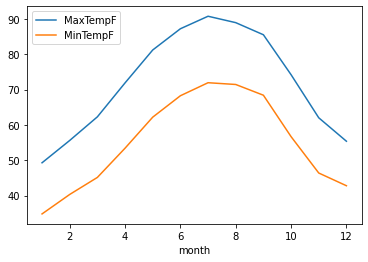

In [116]:
x.plot(y=['MaxTempF', 'MinTempF'])

In [ ]:
px_plot = px.line(f, x='month', y='MinTempF')
px_plot

In [256]:
px.line(x, y ='MaxTempF')

In [13]:
# pd.options.plotting.backend = "plotly"
# gh = px.line(df, title=df['City_State'].iloc[0], x='date_time', y=['MaxTempF', 'MinTempF'])

In [ ]:
# df1 = df.melt(id_vars=['']+list(df.keys()[5:]), var_name='Temp')
# px.line(df1, x='month', y='MaxTempF', color='Temp')

In [173]:
fig = px.line(df, x=['month', 'month'], y=['MaxTempF', 'MinTempF'])
fig

In [ ]:
import plotly.graph_objects as go

In [68]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=subset['date_time'], y=subset['MaxTempF'],
                    mode='lines+markers',
                    name='lines+markers'))
fig

### **INDICATOR_ID**

Z1BR = 1-Bedroom Time Series ($)

In [ ]:
print(df.shape)
df.head()

In [ ]:
df['postal'].nunique()

45

In [ ]:
df_xyz['city_state'].nunique()

623

### MISSING:

AK - Alaska

DE - Delaware

HI - Hawaii

ME - Maine

VT - Vermont

WV - West Virginia

In [ ]:
sorted(df['postal'].unique())

['AL',
 'AR',
 'AZ',
 'CA',
 'CO',
 'CT',
 'DC',
 'FL',
 'GA',
 'IA',
 'ID',
 'IL',
 'IN',
 'KS',
 'KY',
 'LA',
 'MA',
 'MD',
 'MI',
 'MN',
 'MO',
 'MS',
 'MT',
 'NC',
 'ND',
 'NE',
 'NH',
 'NJ',
 'NM',
 'NV',
 'NY',
 'OH',
 'OK',
 'OR',
 'PA',
 'RI',
 'SC',
 'SD',
 'TN',
 'TX',
 'UT',
 'VA',
 'WA',
 'WI',
 'WY']

In [ ]:
df_xyz['postal'].value_counts()

CA    38668
FL    14271
TX    13966
WA     6456
MA     5126
AZ     4691
MN     4604
CO     4452
UT     4139
MI     4100
NJ     3591
IN     3555
NC     3188
IL     3066
OR     2950
NY     2950
MO     2694
VA     2692
OK     2505
OH     2475
GA     2470
TN     2360
WI     2300
IA     2295
KS     1992
PA     1939
ID     1928
CT     1575
MD     1475
LA     1416
NV     1303
AR     1128
NM      916
RI      885
SC      855
NE      811
AL      699
ND      558
MT      540
MS      509
KY      470
WY      433
SD      408
DC      295
NH      230
Name: postal, dtype: int64

In [ ]:
df_2020 = df_xyz[df_xyz['date'] >= '2020-07-30']
df_2020

,date,indicator_id,region_id,city,postal,city_state,value
162892,2020-07-31,Z1BR,17222,Buffalo,NY,"Buffalo, NY","183,698.0"
162893,2020-07-31,Z1BR,32629,Madera,CA,"Madera, CA","154,326.0"
162894,2020-07-31,Z1BR,19410,Mishawaka,IN,"Mishawaka, IN","73,941.0"
162895,2020-07-31,Z1BR,26922,Saint Petersburg,FL,"Saint Petersburg, FL","112,052.0"
162896,2020-07-31,Z1BR,4151,Coconut Creek,FL,"Coconut Creek, FL","107,413.0"
...,...,...,...,...,...,...,...
163564,2020-07-31,Z1BR,10843,Clarksville,TN,"Clarksville, TN","149,448.0"
163565,2020-07-31,Z1BR,26374,Palo Alto,CA,"Palo Alto, CA","1,377,370.0"
163567,2020-07-31,Z1BR,38333,El Cajon,CA,"El Cajon, CA","245,799.0"
163568,2020-07-31,Z1BR,53978,Portsmouth,VA,"Portsmouth, VA","146,105.0"
